# Packages

In [4]:
import osmnx as ox
import pandas as pd
import geopandas as gpd
import geodatasets
import matplotlib.pyplot as plt
import numpy as np
import contextily as ctx

# Prepare Data

In [4]:
import os
from pathlib import Path
import pandas as pd
import gzip
from tqdm import tqdm  # <-- progress bar

# --- Base directory ---
base_dir = Path("C:/Users/zollner/OneDrive - epfl.ch/Documents/SGR TZ/Quadrant/year=2025/month=10")
records = []

# --- Collect all .gz files first ---
all_gz_files = []
for day_folder in base_dir.iterdir():
    if day_folder.is_dir():
        for file_path in day_folder.iterdir():
            if file_path.is_file() and file_path.suffix == ".gz":
                all_gz_files.append((day_folder.name, file_path))

# --- Iterate with a progress bar ---
for day, file_path in tqdm(all_gz_files, desc="Processing .gz files"):
    try:
        with gzip.open(file_path, 'rt', encoding='utf-8') as f:
            for line in f:
                line = line.strip()
                if not line:
                    continue
                content_parts = [p.strip() if p.strip() != "" else None for p in line.split(",")]
                content_parts += [None] * (16 - len(content_parts))  # ensure 16 variables
                record = {
                    "day": day,
                    "file_name": file_path.name,
                    "device_id": content_parts[0],
                    "id_type": content_parts[1],
                    "latitude": content_parts[2],
                    "longitude": content_parts[3],
                    "horizontal_accuracy": content_parts[4],
                    "timestamp": content_parts[5],
                    "ip_address": content_parts[6],
                    "device_os": content_parts[7],
                    "user_agent": content_parts[8],
                    "country": content_parts[9],
                    "source_id": content_parts[10],
                    "publisher_id": content_parts[11],
                    "geohash": content_parts[12],
                    "consent": content_parts[13],
                    "device_manufacturer": content_parts[14],
                    "device_model": content_parts[15],
                }
                records.append(record)
    except Exception as e:
        print(f"Skipping {file_path.name}: {e}")

# --- Convert to DataFrame ---
df = pd.DataFrame(records)

# --- Save ---
df.to_csv(base_dir / "parsed_16_variables.csv", index=False)

print(f"Total rows found: {len(df)}")


Processing .gz files:   0%|          | 0/35 [00:00<?, ?it/s]

Processing .gz files: 100%|██████████| 35/35 [00:41<00:00,  1.17s/it]


Total rows found: 6821377


In [5]:
data = pd.read_csv('C:/Users/zollner/OneDrive - epfl.ch/Documents/SGR TZ/Quadrant/year=2025/month=10/parsed_16_variables.csv')
data

,day,file_name,device_id,id_type,latitude,longitude,horizontal_accuracy,timestamp,ip_address,device_os,user_agent,country,source_id,publisher_id,geohash,consent,device_manufacturer,device_model
0,day=01,000000_0_5951a46c-07ec-405d-aba4-a045370678bf_...,63216cc1-1f8c-4112-a860-fecf3d4ddc0b,aaid,-3.415847,36.711733,532.0,1759325078000,NaN,Android,NaN,TZ,61,2020,kz6he6htjrun,Y,NaN,NaN
1,day=01,000000_0_5951a46c-07ec-405d-aba4-a045370678bf_...,4f212a79-46f2-4369-87e5-066262bc30cc,aaid,-3.344441,37.345011,433.0,1759334865000,197.186.63.101,Android,NaN,TZ,61,2020,kz6scz1v1z4b,Y,NaN,NaN
2,day=01,000000_0_5951a46c-07ec-405d-aba4-a045370678bf_...,d22c0e22-73f5-4287-a827-02262f6c20eb,aaid,-3.369252,36.582276,3198.0,1759298955000,NaN,Android,Mozilla/5.0 (Linux; Android 10; SM-G960F Build...,TZ,58,1dda65de808c6086b8cc633a6dbd320e,kz6hb6wksvfk,Y,NaN,SM-G960F
3,day=01,000000_0_5951a46c-07ec-405d-aba4-a045370678bf_...,2713cb71-fa3f-4722-86ba-605017ab5886,aaid,-3.370726,36.689256,92.0,1759297694000,NaN,Android,NaN,TZ,61,2020,kz6hffkk1ehj,Y,NaN,NaN
4,day=01,000000_0_5951a46c-07ec-405d-aba4-a045370678bf_...,8DF8275E-E1FB-4EC4-A7D6-582A3F44E6A8,idfa,-3.392585,36.704906,5.6,1759331253000,NaN,iOS,NaN,TZ,58,8826dbc0dba06d52a75807525d5ff255,kz6henrsy23d,Y,NaN,iPhone12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6821372,day=07,000004_0_66692715-5849-4e42-ab90-b02aeb886104_...,0751b78a-6e58-4fbe-a6d0-c1fa7c162bf1,aaid,-6.864424,39.226354,548.0,1759872112000,NaN,Android,NaN,TZ,61,2020,kygbuw7gb69e,Y,NaN,NaN
6821373,day=07,000004_0_66692715-5849-4e42-ab90-b02aeb886104_...,eb10226d-bb2d-44bf-a626-b17b451763bf,aaid,-6.709915,39.229544,7.0,1759844097000,NaN,Android,NaN,TZ,58,f7cceb4540d611ea2d200e6b4470652a,kygcudqpfthr,Y,NaN,SM-G970F
6821374,day=07,000004_0_66692715-5849-4e42-ab90-b02aeb886104_...,46af1ee8-c431-4b77-a73e-a5e122d73a3a,aaid,-6.791860,39.147069,898.0,1759878615000,NaN,Android,Mozilla/5.0 (Linux; Android 9; Infinix X650B B...,TZ,58,aa1e4eeb7d6264d1babb1ffaffadaa66,kygc6gd48cd4,Y,NaN,Infinix X650B
6821375,day=07,000004_0_66692715-5849-4e42-ab90-b02aeb886104_...,030afed9-2088-4403-8a95-54744329ebd4,aaid,-6.710000,39.110000,1105.0,1759866846000,41.222.177.246,Android,NaN,TZ,58,9922,kygccfrp3j3d,Y,NaN,NaN


## Edit Data

1. Edit timestamp

In [6]:
import pandas as pd
import numpy as np

def convert_epoch_to_datetime(series, to_timezone='Africa/Dar_es_Salaam'):
    """
    Convert numeric or string epoch timestamps (seconds or milliseconds)
    to pandas datetimes in Tanzania local time.
    """
    s = pd.to_numeric(series, errors='coerce')
    
    # Detect seconds vs milliseconds
    if s.mean() > 1e12:
        unit = 'ms'
    else:
        unit = 's'

    # Convert to UTC first, then to local timezone
    dt = pd.to_datetime(s, unit=unit, utc=True)
    if to_timezone:
        dt = dt.dt.tz_convert(to_timezone)
    return dt

# ---- Usage example ----
data['timestamp'] = convert_epoch_to_datetime(data['timestamp'])
print(data['timestamp'].head())
print(data['timestamp'].dtype)


0   2025-10-01 16:24:38+03:00
1   2025-10-01 19:07:45+03:00
2   2025-10-01 09:09:15+03:00
3   2025-10-01 08:48:14+03:00
4   2025-10-01 18:07:33+03:00
Name: timestamp, dtype: datetime64[ns, Africa/Dar_es_Salaam]
datetime64[ns, Africa/Dar_es_Salaam]


# Data Completeness and Noise

In [7]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6821377 entries, 0 to 6821376
Data columns (total 18 columns):
 #   Column               Dtype                               
---  ------               -----                               
 0   day                  object                              
 1   file_name            object                              
 2   device_id            object                              
 3   id_type              object                              
 4   latitude             float64                             
 5   longitude            float64                             
 6   horizontal_accuracy  float64                             
 7   timestamp            datetime64[ns, Africa/Dar_es_Salaam]
 8   ip_address           object                              
 9   device_os            object                              
 10  user_agent           object                              
 11  country              object                              
 12  

In [16]:

# Missing values: Count missing lat/long, timestamps, or user IDs.
missing_values = data.isnull().sum()
print("Missing values per column:", missing_values)

# Duplicates: Identify duplicate pings or overlapping records.
duplicates = data[["latitude", "longitude"]].duplicated().sum()
print("Number of duplicate pings:", duplicates)

duplicates_time = data[["latitude", "longitude", "timestamp"]].duplicated().sum()
print("Number of duplicate pings:", duplicates_time)

duplicates_gps = data[["latitude", "longitude", "device_id"]].duplicated().sum()
print("Number of duplicate pings:", duplicates_gps)

duplicates_id = data[["latitude", "longitude", "timestamp", "device_id"]].duplicated().sum()
print("Number of duplicate pings:", duplicates_id)
duplicate_rows = data[data[["latitude", "longitude", "timestamp", "device_id"]].duplicated(keep=False)]


Missing values per column: day                          0
file_name                    0
device_id                    0
id_type                      0
latitude                     0
longitude                    0
horizontal_accuracy          0
timestamp                    0
ip_address             3510511
device_os                    0
user_agent             4319729
country                      0
source_id                    0
publisher_id                 0
geohash                      0
consent                      0
device_manufacturer    5956887
device_model           3893122
lat_next                     0
lon_next                     0
time_next                    0
dist_km                      0
dt_hours                     0
speed_kmh                    0
dtype: int64
Number of duplicate pings: 2351394
Number of duplicate pings: 51471
Number of duplicate pings: 1757201
Number of duplicate pings: 0


No relevant variables are missing. There are missing values for ip_address, user_agent (e.g. Mozilla or Chrome), device_manufacturer (e.g., Samsung, Motorola), device_model (e.g. SM-G950F). 
For one week of data we have 6 821 377 pings. 2 542 077, so around 37% are duplicates in terms of GPS location, 1845616 (27%) in terms of location and device, 65216 in terms of location and time, 0 in terms of user_id, location & time. 

Without high-speed pings: 2351394, 1757201, 51471 - similar numbers

In [17]:
# Check duplicated locations for same device_id
duplicated_locations = data[data.duplicated(subset=['device_id', 'latitude', 'longitude'], keep=False)]
print("Duplicated locations for same device_id:")
print(duplicated_locations)

# Count unique device IDs for duplicated locations
unique_device_ids = duplicated_locations['device_id'].nunique()
print("Number of unique device IDs with duplicated locations:", unique_device_ids)


Duplicated locations for same device_id:
            day                                          file_name  \
5647028  day=06  000003_0_ebf8f5e4-1612-4dd7-addf-2ce6ac081e1f_...   
5576668  day=06  000003_0_ebf8f5e4-1612-4dd7-addf-2ce6ac081e1f_...   
5653230  day=06  000003_0_ebf8f5e4-1612-4dd7-addf-2ce6ac081e1f_...   
5669749  day=06  000003_0_ebf8f5e4-1612-4dd7-addf-2ce6ac081e1f_...   
6490943  day=07  000003_0_335b9e89-fd15-4d0f-b95d-6f95b6d71c11_...   
...         ...                                                ...   
4805399  day=05  000004_0_b51a28c4-f27e-453f-8b10-a90a6e3e9a3d_...   
4805725  day=05  000004_0_b51a28c4-f27e-453f-8b10-a90a6e3e9a3d_...   
4723621  day=05  000004_0_b51a28c4-f27e-453f-8b10-a90a6e3e9a3d_...   
839324   day=01  000004_0_ef64a9aa-3434-4a9f-a40e-44b4d7321d3f_...   
858103   day=01  000004_0_ef64a9aa-3434-4a9f-a40e-44b4d7321d3f_...   

                                    device_id id_type  latitude  longitude  \
5647028  00033a0b-77f3-489e-82f0-5868113

There are 89 983 (44%) of users with duplicated locations across the week. I am not sure how to make sure that this is because they visit the same location, or if this is a mistake. 

Without high-speed pings: 69 193 users

In [18]:

# Count duplicated locations per device but that ocurred on a different day
duplicated_locations_diff_days = data[data.duplicated(subset=['device_id', 'latitude', 'longitude'], keep=False)]
duplicated_locations_diff_days = duplicated_locations_diff_days.groupby(['device_id', 'latitude', 'longitude']).filter(lambda x: x['timestamp'].dt.date.nunique() > 1)
print("Duplicated locations for same device_id on different days:")
print(duplicated_locations_diff_days)

# count how many different days each device_id has duplicated locations
device_days_count = duplicated_locations_diff_days.groupby('device_id')['timestamp'].apply(lambda x: x.dt.date.nunique())
print("Number of different days with duplicated locations per device_id:")
print(device_days_count)

# Summary stats of the counts
device_days_count.describe()

# How many users observed on exactly 8 different days
print(device_days_count[device_days_count == 8].count())


Duplicated locations for same device_id on different days:
            day                                          file_name  \
5647028  day=06  000003_0_ebf8f5e4-1612-4dd7-addf-2ce6ac081e1f_...   
5576668  day=06  000003_0_ebf8f5e4-1612-4dd7-addf-2ce6ac081e1f_...   
5653230  day=06  000003_0_ebf8f5e4-1612-4dd7-addf-2ce6ac081e1f_...   
5669749  day=06  000003_0_ebf8f5e4-1612-4dd7-addf-2ce6ac081e1f_...   
6490943  day=07  000003_0_335b9e89-fd15-4d0f-b95d-6f95b6d71c11_...   
...         ...                                                ...   
4825521  day=05  000004_0_b51a28c4-f27e-453f-8b10-a90a6e3e9a3d_...   
4832143  day=05  000004_0_b51a28c4-f27e-453f-8b10-a90a6e3e9a3d_...   
4843867  day=05  000004_0_b51a28c4-f27e-453f-8b10-a90a6e3e9a3d_...   
4851997  day=05  000004_0_b51a28c4-f27e-453f-8b10-a90a6e3e9a3d_...   
4725118  day=05  000004_0_b51a28c4-f27e-453f-8b10-a90a6e3e9a3d_...   

                                    device_id id_type  latitude  longitude  \
5647028  00033a0b-77f3

There are 669 users (0.3%) that have repeated locations every day. Some of these patterns still look reasonable though. I am not sure how to filter reliable from unrealiable data. 

Without high-speed pings: 565 users

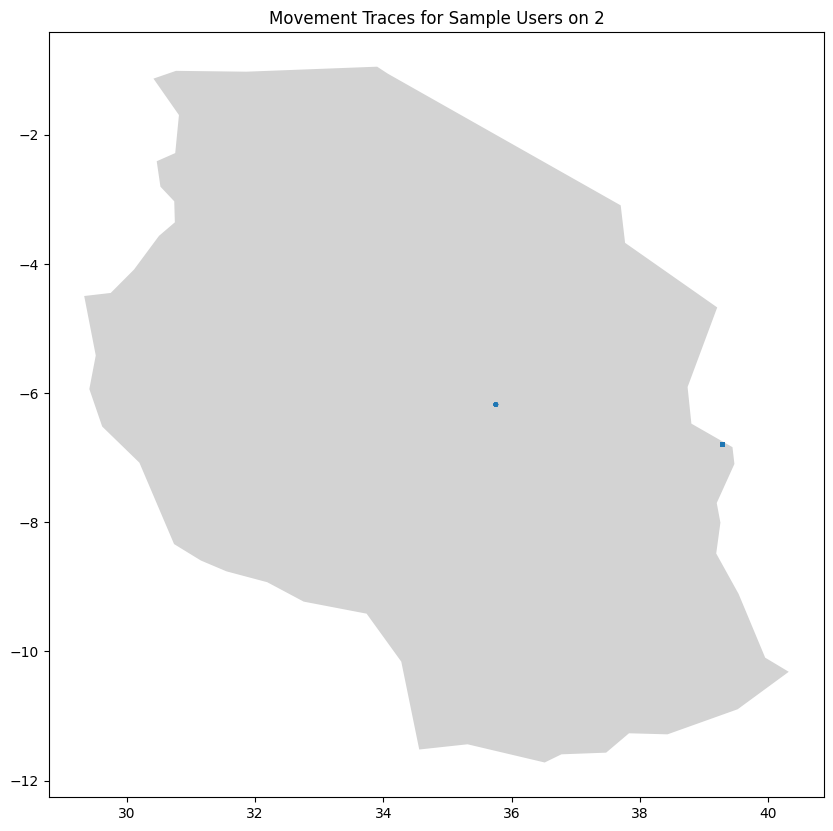

In [31]:
# Check the cities in which these duplicated locations occur. 
 
#sample_users = ['c357414e-4d08-4b60-a2bb-a513efb88505']
sample_users = ['cbe2385b-a779-4083-bf8d-9fc76dcca5a6']
sample_date = "2025-10-06"
sample_data = data[
    (data['device_id'].isin(sample_users)) &
    (data['timestamp'].dt.date == pd.to_datetime(sample_date).date())
]
sample_gdf = gpd.GeoDataFrame(sample_data, geometry=gpd.points_from_xy(sample_data.longitude, sample_data.latitude), crs="EPSG:4326")
fig, ax = plt.subplots(figsize=(10, 10))
url = "https://naturalearth.s3.amazonaws.com/110m_cultural/ne_110m_admin_0_countries.zip"
world = gpd.read_file(url)
TZ = world[world['ADMIN'] == 'United Republic of Tanzania']
TZ.plot(ax=ax, color='lightgrey')
sample_gdf.plot(ax=ax, column='device_id', legend=False, markersize=5)
plt.title(f'Movement Traces for Sample Users on {sample_date[0]}')
plt.show()




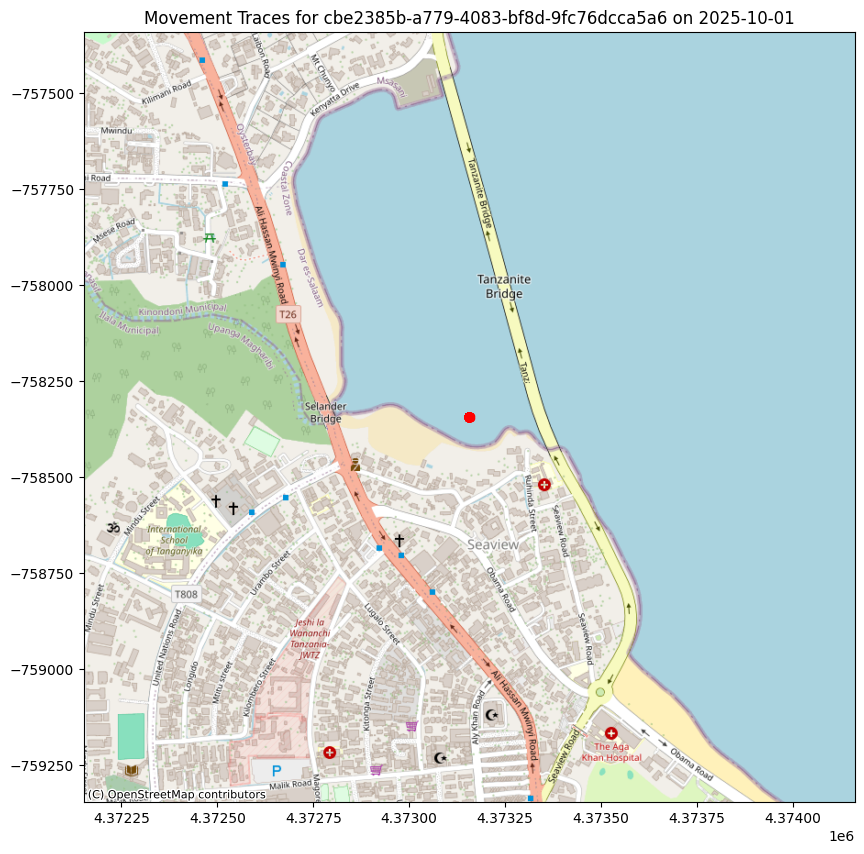

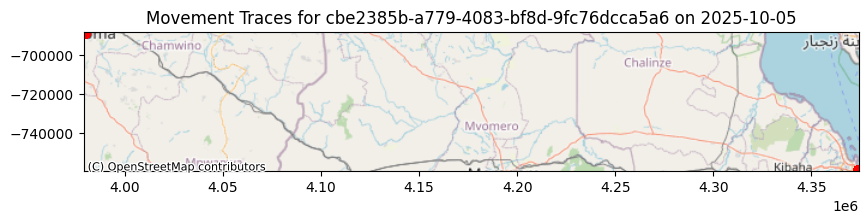

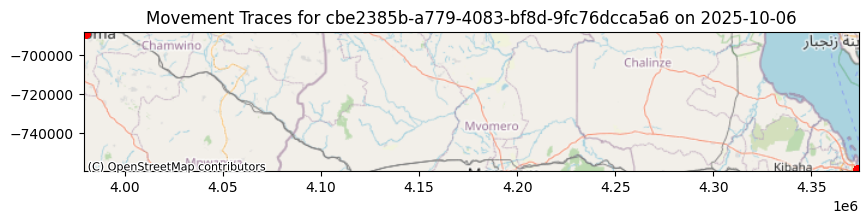

In [32]:
import geopandas as gpd
import matplotlib.pyplot as plt
import contextily as ctx
import pandas as pd

# Sample user and list of dates
sample_user = 'cbe2385b-a779-4083-bf8d-9fc76dcca5a6'
sample_dates = ["2025-10-01", "2025-10-05", "2025-10-06"]

for sample_date in sample_dates:
    # Filter data for the user and date
    sample_data = data[
        (data['device_id'] == sample_user) &
        (data['timestamp'].dt.date == pd.to_datetime(sample_date).date())
    ]
    
    if sample_data.empty:
        print(f"No GPS points for {sample_user} on {sample_date}")
        continue

    # Convert to GeoDataFrame
    sample_gdf = gpd.GeoDataFrame(
        sample_data,
        geometry=gpd.points_from_xy(sample_data.longitude, sample_data.latitude),
        crs="EPSG:4326"
    )

    # Convert to Web Mercator for contextily
    sample_gdf_3857 = sample_gdf.to_crs(epsg=3857)

    # Compute bounding box with padding
    minx, miny, maxx, maxy = sample_gdf_3857.total_bounds
    padding = 1000  # meters

    # Plot
    fig, ax = plt.subplots(figsize=(10, 10))
    sample_gdf_3857.plot(ax=ax, color='red', markersize=20)

    # Zoom to bounding box
    ax.set_xlim(minx - padding, maxx + padding)
    ax.set_ylim(miny - padding, maxy + padding)

    # Add OSM basemap
    ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

    plt.title(f'Movement Traces for {sample_user} on {sample_date}')
    plt.show()


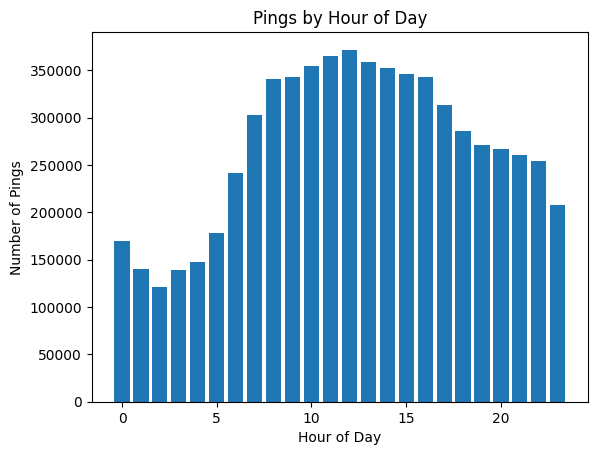

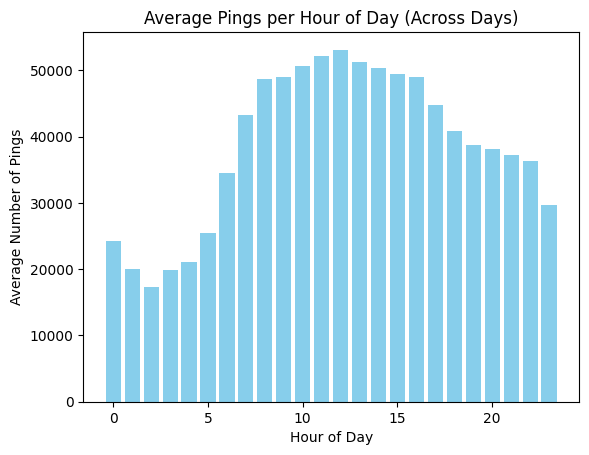

In [19]:
# Battery or app bias: Some datasets show clustering around times when users have internet/battery.
data['hour'] = data['timestamp'].dt.hour
data['date'] = data['timestamp'].dt.date


hourly_counts = data['hour'].value_counts().sort_index()
plt.bar(hourly_counts.index, hourly_counts.values)
plt.xlabel('Hour of Day')
plt.ylabel('Number of Pings')
plt.title('Pings by Hour of Day')
plt.show()

# Average number of pings per hour
pings_per_day_hour = data.groupby(['date', 'hour']).size().reset_index(name='ping_count')
average_pings_per_hour = pings_per_day_hour.groupby('hour')['ping_count'].mean()
plt.bar(average_pings_per_hour.index, average_pings_per_hour.values, color='skyblue')
plt.xlabel('Hour of Day')
plt.ylabel('Average Number of Pings')
plt.title('Average Pings per Hour of Day (Across Days)')
plt.show()


Most pings lie between 8 AM and 4 PM, but I have support across the entire day, even in the middle of the night

# Sample composition 

In [20]:

# Number of unique users: How many unique device IDs are there?
unique_users = data['device_id'].nunique()
print("Number of unique users:", unique_users)

# How long do users stay active in the dataset? (e.g. some might appear only once).
user_persistence = data.groupby('device_id')['date'].nunique()
print("User persistence (number of active days):")
print(user_persistence.describe())

Number of unique users: 152876
User persistence (number of active days):
count    152876.000000
mean          2.222429
std           1.809947
min           1.000000
25%           1.000000
50%           1.000000
75%           3.000000
max           8.000000
Name: date, dtype: float64


There are 204 512 users in the dataset (Benchmark from other papers: 237,123 users in TZ in Blanchard et al. 2023, 22,994 high confidence (but they have three countries), 50 million handsets in the US in Atkin et al. 2022). On average, people are seen for 2 days in a week, 50% only once. This means I cannot necessarily look at high-frequency travelling, but rather at aggregate patterns over longer timespans. 

Without high-speed pings:  152876 users

# Spatial Coverage

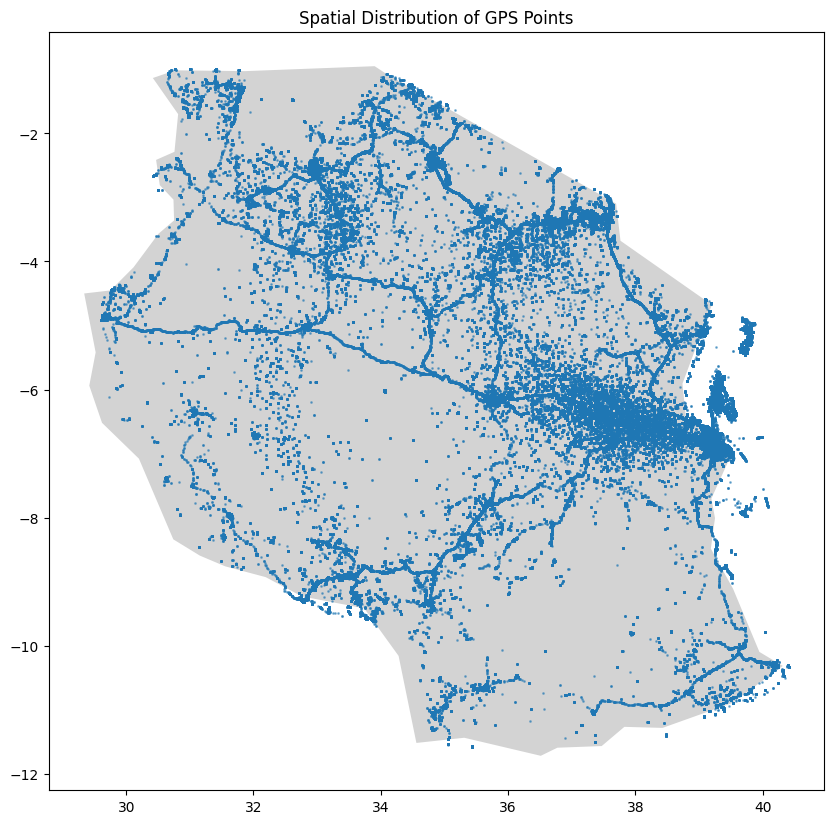

In [21]:
# Coverage: Verify that points cover the study area (e.g. around the SGR corridor, stations, and comparison areas). Are both treatment and control zones well-represented?
gdf = gpd.GeoDataFrame(data, geometry=gpd.points_from_xy(data.longitude, data.latitude), crs="EPSG:4326")
url = "https://naturalearth.s3.amazonaws.com/110m_cultural/ne_110m_admin_0_countries.zip"
world = gpd.read_file(url)
TZ = world[world['ADMIN'] == 'United Republic of Tanzania']

fig, ax = plt.subplots(figsize=(10, 10))
TZ.plot(ax=ax, color='lightgrey')
gdf.plot(ax=ax, markersize=1, alpha=0.5)
plt.title('Spatial Distribution of GPS Points')
plt.show()

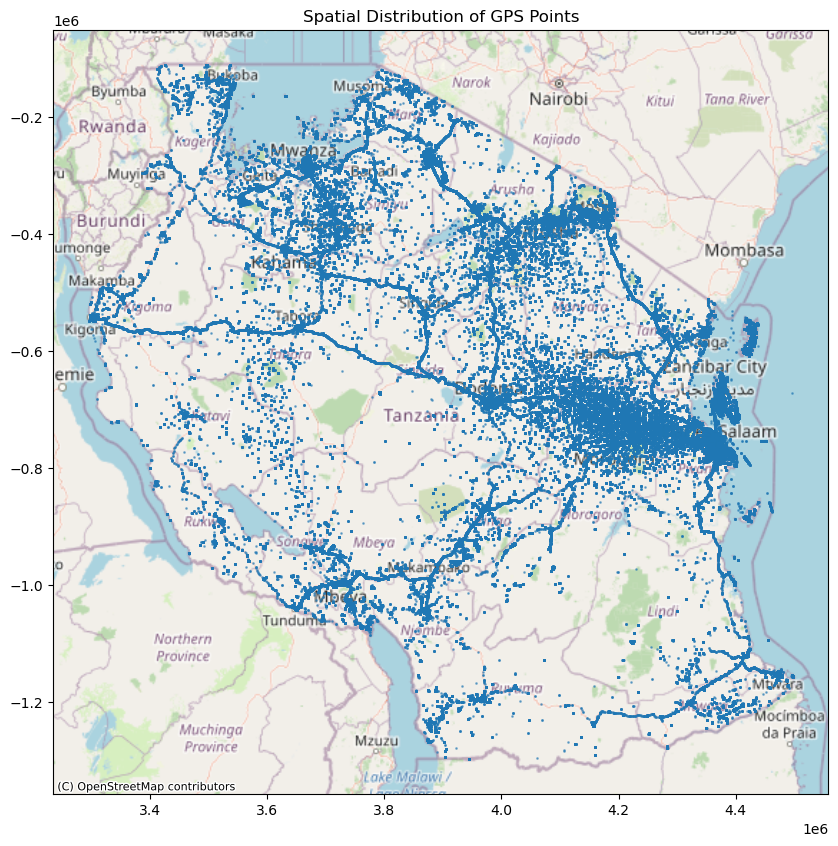

In [19]:
subset = gdf.to_crs(epsg=3857)
fig, ax = plt.subplots(figsize=(10, 10))
subset.plot(ax=ax, markersize=1, alpha=0.5)
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)
plt.title('Spatial Distribution of GPS Points')
plt.show()

In [ ]:
# Spatial accuracy: Are points snapped to realistic locations (roads, urban centers, etc.)?
subset = gdf.cx[39.2:39.4, -6.9:-6.7].to_crs(epsg=3857) # subset to a smaller bounding box (Dar es Salaam to Dodoma)
fig, ax = plt.subplots(figsize=(10, 10))
subset.plot(ax=ax, markersize=2, alpha=0.6, color='blue')
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)
ax.set_title("GPS Points over OSM – Dar es Salaam to Dodoma", fontsize=14)
plt.tight_layout()
plt.show()

Longitude decimal places stats:
count    6.821377e+06
mean     5.890080e+00
std      1.263535e+00
min      1.000000e+00
25%      5.000000e+00
50%      6.000000e+00
75%      7.000000e+00
max      8.000000e+00
Name: lon_decimal_places, dtype: float64
Latitude decimal places stats:
count    6.821377e+06
mean     6.050720e+00
std      1.397431e+00
min      1.000000e+00
25%      5.000000e+00
50%      7.000000e+00
75%      7.000000e+00
max      8.000000e+00
Name: lat_decimal_places, dtype: float64


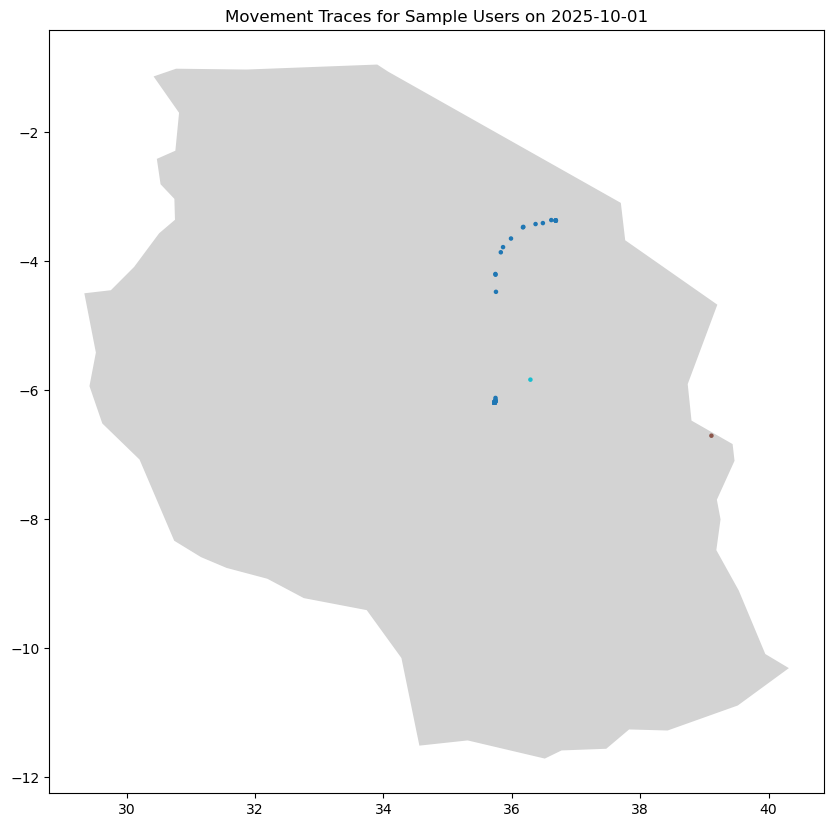

In [20]:
# Spatial resolution: Check the precision of coordinates (number of decimal places). You need ~5 decimal digits (~1 m accuracy) for reliable trip-level analysis.
gdf['lon_decimal_places'] = gdf['longitude'].apply(lambda x: len(str(x).split('.')[-1]) if '.' in str(x) else 0)
gdf['lat_decimal_places'] = gdf['latitude'].apply(lambda x: len(str(x).split('.')[-1]) if '.' in str(x) else 0)
print("Longitude decimal places stats:")
print(gdf['lon_decimal_places'].describe())
print("Latitude decimal places stats:")
print(gdf['lat_decimal_places'].describe())

# Quick test: Map 1 day of data for 5–10 users — does the movement trace align with real roads and stations?
 # --> Ideally I would plot movement traces here, but for most users I only have one point in the dataset
 
sample_date = data['date'].iloc[0]
sample_users = data['device_id'].drop_duplicates().sample(10, random_state=1).values
sample_data = data[(data['date'] == sample_date) & (data['device_id'].isin(sample_users))]
sample_gdf = gpd.GeoDataFrame(sample_data, geometry=gpd.points_from_xy(sample_data.longitude, sample_data.latitude), crs="EPSG:4326")
fig, ax = plt.subplots(figsize=(10, 10))
TZ.plot(ax=ax, color='lightgrey')
sample_gdf.plot(ax=ax, column='device_id', legend=False, markersize=5)
plt.title(f'Movement Traces for Sample Users on {sample_date}')
plt.show()

In terms of spatial coverage, I definitely have good coverage in Dar es Salaam, Dodoma and in between. I also have data in untreated regions, but mainly in bigger cities and main roads. Accuracy of the GPS points looks good with 5-6 digits in the first quantile. In terms of travel patterns, there are some traces that actually show movements, but for many users we do not have much variation in spatial movements across pings.
 

# Temporal Coverage

Ping frequency statistics (seconds):
count    6.476565e+06
mean     9.338129e-02
std      2.918012e-01
min      0.000000e+00
25%      0.000000e+00
50%      0.000000e+00
75%      0.000000e+00
max      9.000000e+00
Name: timestamp, dtype: float64
Ping frequency statistics per user (seconds):
count    6.323690e+06
mean     3.605195e+03
std      2.115400e+04
min      0.000000e+00
25%      4.300000e+01
50%      3.400000e+02
75%      6.310000e+02
max      5.936460e+05
Name: timestamp, dtype: float64
Average pings per user: 42.36483162824773
Number of long gaps (30 min): 0
Number of long gaps (30 min): 840027


Text(0.5, 0, 'Time Interval Between Pings (minutes)')

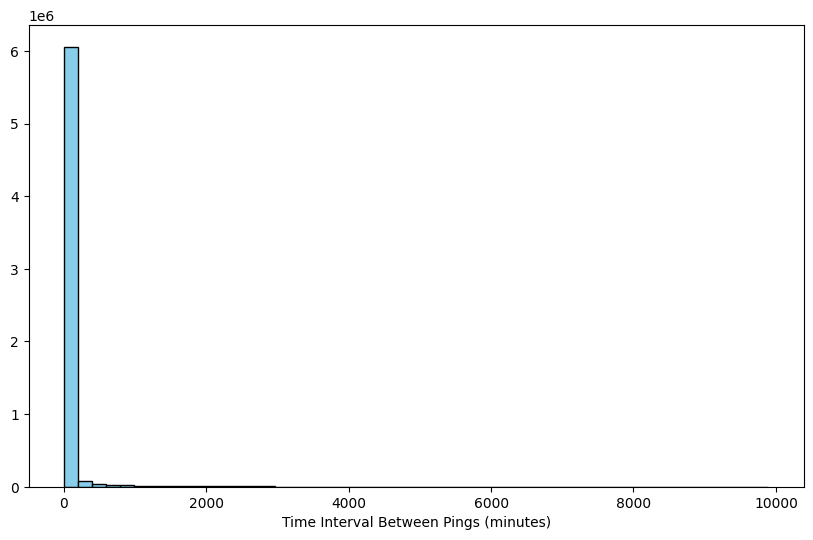

In [22]:
# Granularity: How frequent are GPS pings?
frequency = data['timestamp'].sort_values().diff().dt.total_seconds().dropna()
print("Ping frequency statistics (seconds):")
print(frequency.describe())

frequency_per_user = data.groupby('device_id')['timestamp'].apply(lambda x: x.sort_values().diff().dt.total_seconds().dropna())
print("Ping frequency statistics per user (seconds):")
print(frequency_per_user.describe())

# How many pings per user are there on average?
avg_pings_per_user = data.groupby('device_id').size().mean()
print(f'Average pings per user: {avg_pings_per_user}')

# Consistency: Are timestamps regular? Are there long gaps (e.g., missing nights or weekends)?
gaps = frequency[frequency > 60 * 30]  # gaps longer than 30 minutes
print(f"Number of long gaps (30 min): {gaps.count()}")

gaps = frequency_per_user[frequency_per_user > 60 * 30]  # gaps longer than 30 minutes
print(f"Number of long gaps (30 min): {gaps.count()}")

# Quick test: Plot time intervals between consecutive pings per user to detect irregular sampling.
plt.figure(figsize=(10, 6))
plt.hist(frequency_per_user / 60, bins=50, color='skyblue', edgecolor='black')
plt.xlabel('Time Interval Between Pings (minutes)') 

Average distinct hours observed per phone: 2.50
count    152876.000000
mean          2.501605
std           3.007443
min           1.000000
25%           1.000000
50%           1.000000
75%           2.000000
max          22.714286
Name: avg_hours_per_day, dtype: float64


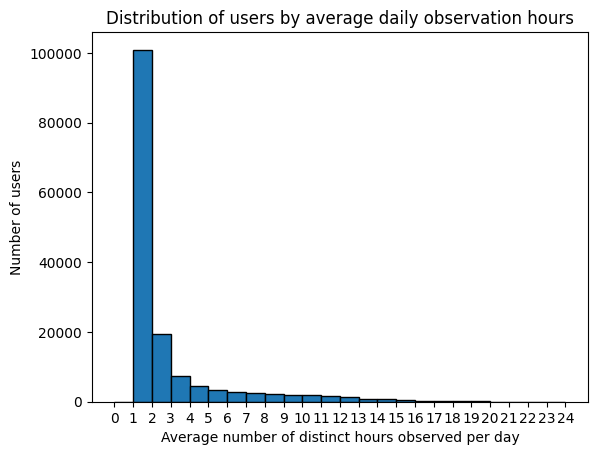

In [23]:
# Conditional on observing a phone ping, what is the duration per day that I observe that phone?

# Count number of distinct hours with at least one ping per device per day
hours_observed = (
    data.groupby(['device_id', 'date'])['hour']
    .nunique()
    .reset_index(name='hours_observed')
)

avg_hours_per_phone = hours_observed.groupby('device_id')['hours_observed'].mean()
print(f'Average distinct hours observed per phone: {avg_hours_per_phone.mean():.2f}')

avg_hours_per_user = (
    hours_observed.groupby('device_id')['hours_observed']
    .mean()
    .reset_index(name='avg_hours_per_day')
)

print(avg_hours_per_user['avg_hours_per_day'].describe())

plt.hist(avg_hours_per_user['avg_hours_per_day'], bins=range(0, 25), edgecolor='black')
plt.xlabel('Average number of distinct hours observed per day')
plt.ylabel('Number of users')
plt.title('Distribution of users by average daily observation hours')
plt.xticks(range(0, 25))
plt.show()

Across all users, I have pings at a very high frequency (less than a second between pings). For each user, the gaps are bigger, with 5 minutes at the median. Across the week, I have 33 pings per user on average. Per day, I observer users on average at 2 different hours, with a majority of users being observed for one distinct hour a day, conditional on being observed that day. 

## Possibility of identifying home location

How many people do I observe during the night?

In [24]:
# Define "overnight" as 7 PM to 7 AM
data['overnight'] = data['hour'].ge(19) | data['hour'].lt(7)

#  Map overnight points to "night date"
# Observations after midnight count toward the previous night
gps_overnight = data[data['overnight']].copy()
gps_overnight['night_date'] = gps_overnight['timestamp'].dt.date
gps_overnight.loc[gps_overnight['hour'] < 6, 'night_date'] = (
    gps_overnight.loc[gps_overnight['hour'] < 6, 'night_date'] - pd.to_timedelta(1, unit='d')
)

# Count nights per user
user_nights = gps_overnight.groupby('device_id')['night_date'].nunique().reset_index()
user_nights.rename(columns={'night_date': 'n_nights_observed'}, inplace=True)

# Optional - how many users have at least one overnight observation
n_users_overnight = user_nights.shape[0]


print(user_nights.head())
print("Number of users observed overnight at least once:", n_users_overnight)

describe_stats = user_nights['n_nights_observed'].describe()
print("Statistics of nights observed per user:", describe_stats)

                              device_id  n_nights_observed
0  00022eb6-0df7-41bd-8d7c-7d9ca29bea68                  1
1  0004F3DF-079D-45B6-849E-BC53D2E834BD                  2
2  0004f3df-079d-45b6-849e-bc53d2e834bd                  3
3  0006f5b6-1caf-4d2c-addd-15b8e0b36fe6                  1
4  0006f5b6-2caf-4d2c-addd-25b8e0b36fe6                  2
Number of users observed overnight at least once: 89202
Statistics of nights observed per user: count    89202.000000
mean         2.284938
std          1.880098
min          1.000000
25%          1.000000
50%          1.000000
75%          3.000000
max          8.000000
Name: n_nights_observed, dtype: float64


How many people are in the same location at night? Within and between individuals

In [25]:
from geopy.distance import great_circle

gps_overnight = gpd.GeoDataFrame(
    gps_overnight,
    geometry=gpd.points_from_xy(gps_overnight.longitude, gps_overnight.latitude),
    crs="EPSG:4326"
)

# Get nightly mean location per user
night_locs = (
    gps_overnight
    .groupby(['device_id', 'night_date'])
    .agg({'latitude':'mean', 'longitude':'mean'})
    .reset_index()
)

# Count nights per user
night_counts = night_locs.groupby('device_id')['night_date'].nunique().reset_index(name='n_nights')

# Filter users with >1 night
multi_night_users = night_counts[night_counts['n_nights'] > 1]['device_id']
night_locs_multi = night_locs[night_locs['device_id'].isin(multi_night_users)]

# Compute distance between all pairs of nights per user
def max_night_distance(df):
    coords = list(zip(df['latitude'], df['longitude']))
    dists = [great_circle(a, b).kilometers for i, a in enumerate(coords) for b in coords[i+1:]]
    return max(dists) if dists else 0

user_night_distance = (
    night_locs_multi.groupby('device_id')
    .apply(max_night_distance)
    .reset_index(name='max_distance_km')
)

# Define “same location” threshold (e.g., 5 km)
same_loc_thresh = 1
user_night_distance['same_location'] = user_night_distance['max_distance_km'] <= same_loc_thresh

# Summary: fraction of users at same location vs moved
summary = user_night_distance['same_location'].value_counts(normalize=True)

# Convert to DataFrame explicitly
summary = summary.rename_axis('status').reset_index(name='share')

# Map True/False to readable labels
summary['status'] = summary['status'].map({
    True: 'Consistent overnight location',
    False: 'Moved between nights'
})

print(summary)



                          status     share
0  Consistent overnight location  0.556393
1           Moved between nights  0.443607


C:\Users\zollner\AppData\Local\Temp\ipykernel_22856\237118866.py:32: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  .apply(max_night_distance)


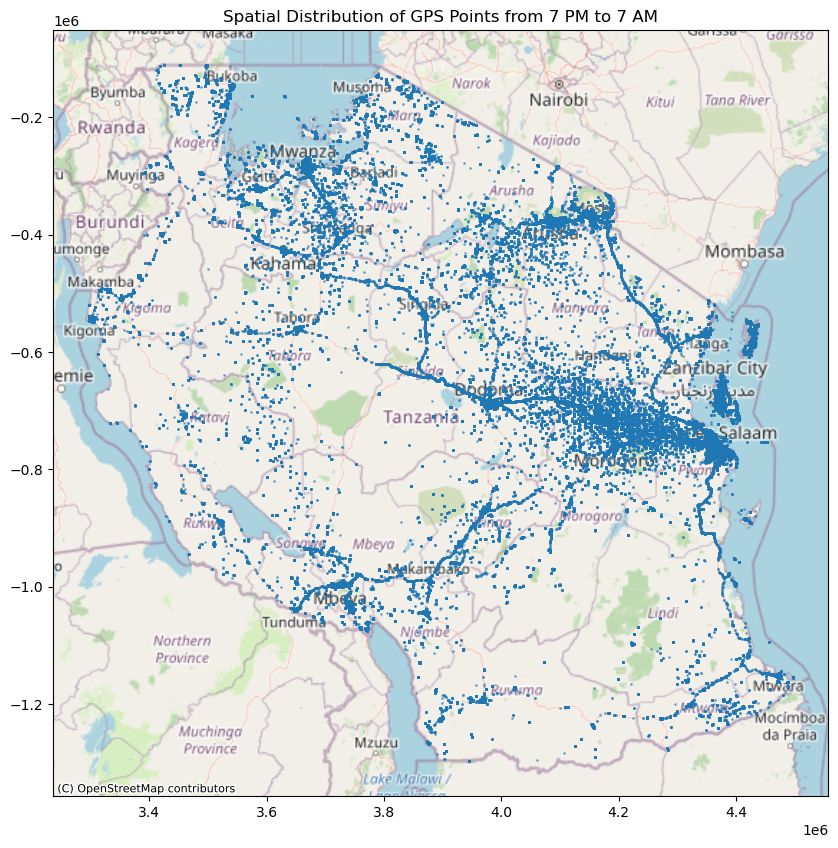

In [43]:
subset = gps_overnight.to_crs(epsg=3857)
fig, ax = plt.subplots(figsize=(10, 10))
subset.plot(ax=ax, markersize=1, alpha=0.5)
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)
plt.title('Spatial Distribution of GPS Points from 7 PM to 7 AM')
plt.show()

Out of 204 512 users, 112 005 are observed during night time at least once. Most of these people are seen on 2 different nights. Out of all users who are observed for more than one night, 55% are seen in a consistent night location. Looking at the map, we observe that the distribution of night pings is still quite good. 

# Trip Reconstruction and Mode Detection

In [26]:
# Trip inference: Can you reliably detect trips (vs stationary periods)? Check if there are users who appear in Dar es Salaam and then later in Dodoma within a day.
    
# 1. Find users with pings in both locations on the same day.
dar_es_salaam_bbox = (39.2, -6.9, 39.4, -6.7)  # (min_lon, min_lat, max_lon, max_lat)
dodoma_bbox = (35.6, -6.3, 35.8, -6.1)  # (min_lon, min_lat, max_lon, max_lat) 

def is_in_bbox(lon, lat, bbox):
    return bbox[0] <= lon <= bbox[2] and bbox[1] <= lat <= bbox[3]

users_in_both_locations = set()

for user_id, group in data.groupby('device_id'):
    for date, day_group in group.groupby('date'):
        in_dar = day_group.apply(lambda row: is_in_bbox(row['longitude'], row['latitude'], dar_es_salaam_bbox), axis=1).any()
        in_dodoma = day_group.apply(lambda row: is_in_bbox(row['longitude'], row['latitude'], dodoma_bbox), axis=1).any()
        if in_dar and in_dodoma:
            users_in_both_locations.add(user_id)
print(f"Users with pings in both Dar es Salaam and Dodoma on the same day: {len(users_in_both_locations)}")

# 2. Check time difference between first ping in Dar es Salaam and last ping in Dodoma on that day.
for user_id in users_in_both_locations:
    user_data = data[data['device_id'] == user_id]
    for date, day_group in user_data.groupby('date'):
        dar_pings = day_group[day_group.apply(lambda row: is_in_bbox(row['longitude'], row['latitude'], dar_es_salaam_bbox), axis=1)]
        dodoma_pings = day_group[day_group.apply(lambda row: is_in_bbox(row['longitude'], row['latitude'], dodoma_bbox), axis=1)]
        if not dar_pings.empty and not dodoma_pings.empty:
            first_dar_time = dar_pings['timestamp'].min()
            last_dodoma_time = dodoma_pings['timestamp'].max()
            time_diff = (last_dodoma_time - first_dar_time).total_seconds() / 3600  # in hours
            print(f"User {user_id} on {date}: Time from Dar es Salaam to Dodoma: {time_diff:.2f} hours")


Users with pings in both Dar es Salaam and Dodoma on the same day: 318
User af1f811c-50fc-4751-ad83-8c31683c2d7d on 2025-10-04: Time from Dar es Salaam to Dodoma: 22.45 hours
User f7e52e15-dc2e-45ad-a377-0ee47cf1301d on 2025-10-02: Time from Dar es Salaam to Dodoma: -8.69 hours
User f7e52e15-dc2e-45ad-a377-0ee47cf1301d on 2025-10-03: Time from Dar es Salaam to Dodoma: -5.86 hours
User f7e52e15-dc2e-45ad-a377-0ee47cf1301d on 2025-10-04: Time from Dar es Salaam to Dodoma: 8.56 hours
User 6022111a-6264-4f3d-a6b3-7c74cc15dbd3 on 2025-10-04: Time from Dar es Salaam to Dodoma: 2.10 hours
User 0b11c3cd-aa21-4748-a0ae-3e08f31ead8a on 2025-10-04: Time from Dar es Salaam to Dodoma: 12.49 hours
User 24cf3831-1b10-4a9d-8871-86dba53d8dee on 2025-10-04: Time from Dar es Salaam to Dodoma: -10.17 hours
User cdd26047-e2ba-460d-ab2a-eae773dccb28 on 2025-10-05: Time from Dar es Salaam to Dodoma: 7.24 hours
User 5D35AB62-46B9-4FF9-8F14-1DCF1EFD9CD6 on 2025-10-01: Time from Dar es Salaam to Dodoma: 4.82 ho

In [28]:
# save device_id, date and time_diff of stay to csv
import pandas as pd

records = []
duration_records = []

for user_id in users_in_both_locations:
    user_data = data[data['device_id'] == user_id]
    for date, day_group in user_data.groupby('date'):
        # Check if they have pings in both locations
        in_dar = day_group.apply(lambda row: is_in_bbox(row['longitude'], row['latitude'], dar_es_salaam_bbox), axis=1).any()
        in_dodoma = day_group.apply(lambda row: is_in_bbox(row['longitude'], row['latitude'], dodoma_bbox), axis=1).any()
        if in_dar and in_dodoma:
            # Filter pings in each city
            dar_pings = day_group[day_group.apply(lambda row: is_in_bbox(row['longitude'], row['latitude'], dar_es_salaam_bbox), axis=1)]
            dodoma_pings = day_group[day_group.apply(lambda row: is_in_bbox(row['longitude'], row['latitude'], dodoma_bbox), axis=1)]
            
            # Compute duration (hours)
            first_dar_time = dar_pings['timestamp'].min()
            last_dodoma_time = dodoma_pings['timestamp'].max()
            duration_hours = (last_dodoma_time - first_dar_time).total_seconds() / 3600
            
            # Record duration per user/day
            duration_records.append({
                'device_id': user_id,
                'date': date,
                'duration_hours': duration_hours
            })
            
            # Add Dar pings
            for _, row in dar_pings.iterrows():
                records.append({
                    'device_id': user_id,
                    'date': date,
                    'city': 'Dar es Salaam',
                    'timestamp': row['timestamp'],
                    'longitude': row['longitude'],
                    'latitude': row['latitude'],
                    'duration_hours': duration_hours
                })
            
            # Add Dodoma pings
            for _, row in dodoma_pings.iterrows():
                records.append({
                    'device_id': user_id,
                    'date': date,
                    'city': 'Dodoma',
                    'timestamp': row['timestamp'],
                    'longitude': row['longitude'],
                    'latitude': row['latitude'],
                    'duration_hours': duration_hours
                })

# Create DataFrames
users_df = pd.DataFrame(records)           # GPS pings + duration per row
duration_df = pd.DataFrame(duration_records)  # Summary per user/day

# Save to CSV
#users_df.to_csv('users_dar_dodoma_pings_with_duration.csv', index=False)
#duration_df.to_csv('users_dar_dodoma_duration_summary.csv', index=False)

#print("Saved CSVs with GPS pings and durations for users in both locations.")


In [20]:
# Read data
users_df = pd.read_csv('users_dar_dodoma_pings_with_duration.csv')

In [30]:
# Describe absolute value of durations, counting every traveler once
users_df_individual = users_df[['device_id', 'date', 'duration_hours']].drop_duplicates()
users_df_individual['duration_hours_abs'] = users_df_individual['duration_hours'].abs()
print(users_df_individual['duration_hours_abs'].describe())

# How many poeple in the users_df dataset have travel durations below 1 hour?
short_travelers = users_df_individual[users_df_individual['duration_hours_abs'] < 1]['device_id'].nunique()
print(f"Number of unique users with travel durations below 1 hour: {short_travelers}")


count    378.000000
mean       8.903770
std        6.109115
min        0.001111
25%        4.023681
50%        7.856806
75%       13.343403
max       23.866389
Name: duration_hours_abs, dtype: float64
Number of unique users with travel durations below 1 hour: 26


There are 395 users within this week who are detected in Dar and Dodoma within the same day. Of course this does not capture all travel between the two cities. 185 of people though who have travel durations of below 1 hour (flight duration between Dar and Dodoma is around 1 hour).

Without high-speed pings: 378 users, 26 travelling below an hour. Why were they not filtered out? Because the ping after the ping that was filtered out is so close in time to the deleted ping, that that one is also unrealistic.

Can I infer their mode of transport? e.g. Did people show up at the airport before arriving in a different city? 

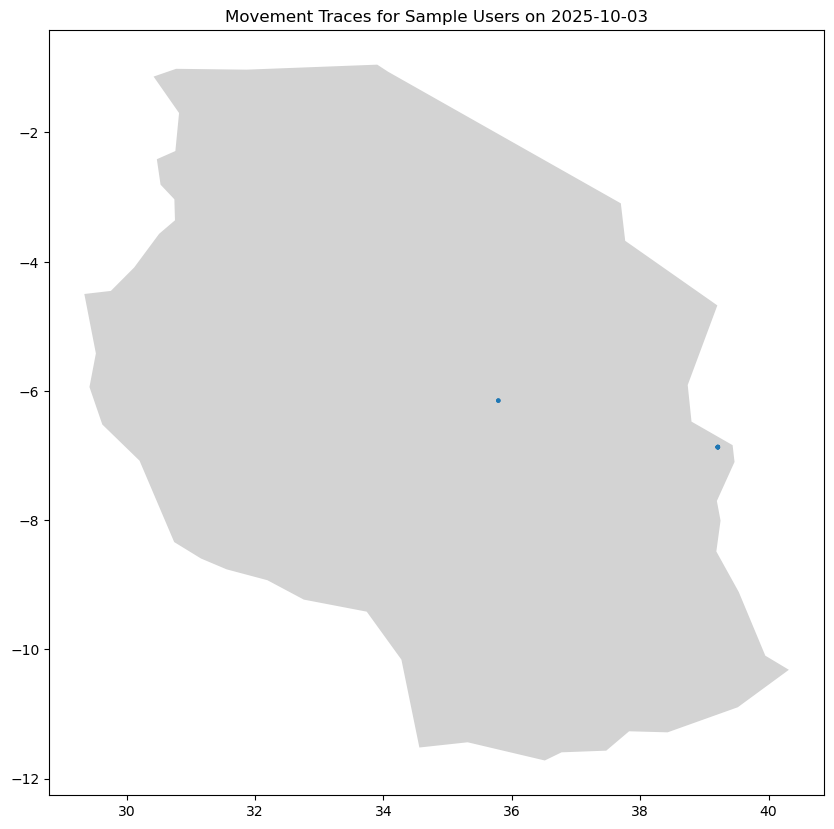

In [27]:
# Quick test: Map traces of travelers
 
#sample_users = ['cbe2385b-a779-4083-bf8d-9fc76dcca5a6']
#sample_users = ['7fd4bec7-d002-48bc-a223-2d198020ba71'] #train travel 
sample_users = ['114af2ce-f73d-49d7-b804-9869c6b7228d'] # air travel
sample_date = ["2025-10-03"]
sample_data = users_df[(users_df['device_id'].isin(sample_users)) & (users_df['date'].isin(sample_date))]
sample_gdf = gpd.GeoDataFrame(sample_data, geometry=gpd.points_from_xy(sample_data.longitude, sample_data.latitude), crs="EPSG:4326")
fig, ax = plt.subplots(figsize=(10, 10))
url = "https://naturalearth.s3.amazonaws.com/110m_cultural/ne_110m_admin_0_countries.zip"
world = gpd.read_file(url)
TZ = world[world['ADMIN'] == 'United Republic of Tanzania']
TZ.plot(ax=ax, color='lightgrey')
sample_gdf.plot(ax=ax, column='device_id', legend=False, markersize=5)
plt.title(f'Movement Traces for Sample Users on {sample_date[0]}')
plt.show()


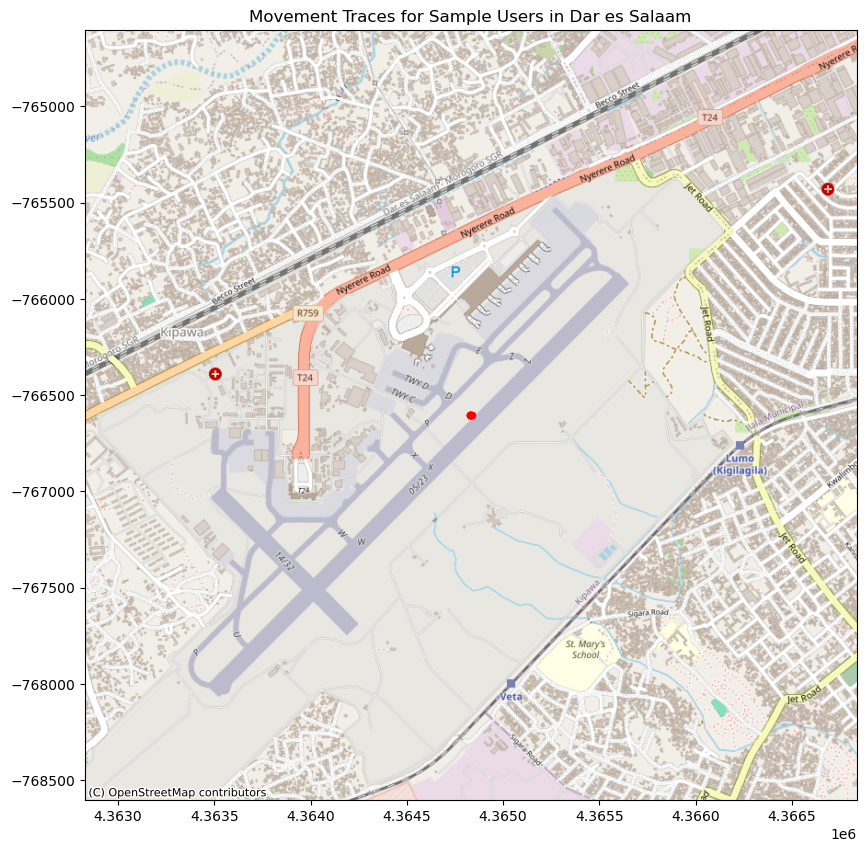

In [31]:
import geopandas as gpd
import matplotlib.pyplot as plt
import contextily as ctx

# Dar bounding box in lon/lat
dar_bbox = (39.2, -6.9, 39.4, -6.7)  # (min_lon, min_lat, max_lon, max_lat)

# Filter sample data for Dar
dar_sample_data = sample_data[
    (sample_data['longitude'] >= dar_bbox[0]) & (sample_data['longitude'] <= dar_bbox[2]) &
    (sample_data['latitude']  >= dar_bbox[1]) & (sample_data['latitude'] <= dar_bbox[3])
]

# Convert to GeoDataFrame
dar_sample_gdf = gpd.GeoDataFrame(
    dar_sample_data,
    geometry=gpd.points_from_xy(dar_sample_data.longitude, dar_sample_data.latitude),
    crs="EPSG:4326"
)

# Convert to Web Mercator
dar_sample_gdf_3857 = dar_sample_gdf.to_crs(epsg=3857)

# Compute bounding box in Web Mercator
minx, miny, maxx, maxy = dar_sample_gdf_3857.total_bounds
padding = 2000  # meters of padding around points

# Plot
fig, ax = plt.subplots(figsize=(10, 10))
dar_sample_gdf_3857.plot(ax=ax, color='red', markersize=20)

# Set axis limits for zoom
ax.set_xlim(minx - padding, maxx + padding)
ax.set_ylim(miny - padding, maxy + padding)

# Add OSM basemap
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

plt.title('Movement Traces for Sample Users in Dar es Salaam')
plt.show()



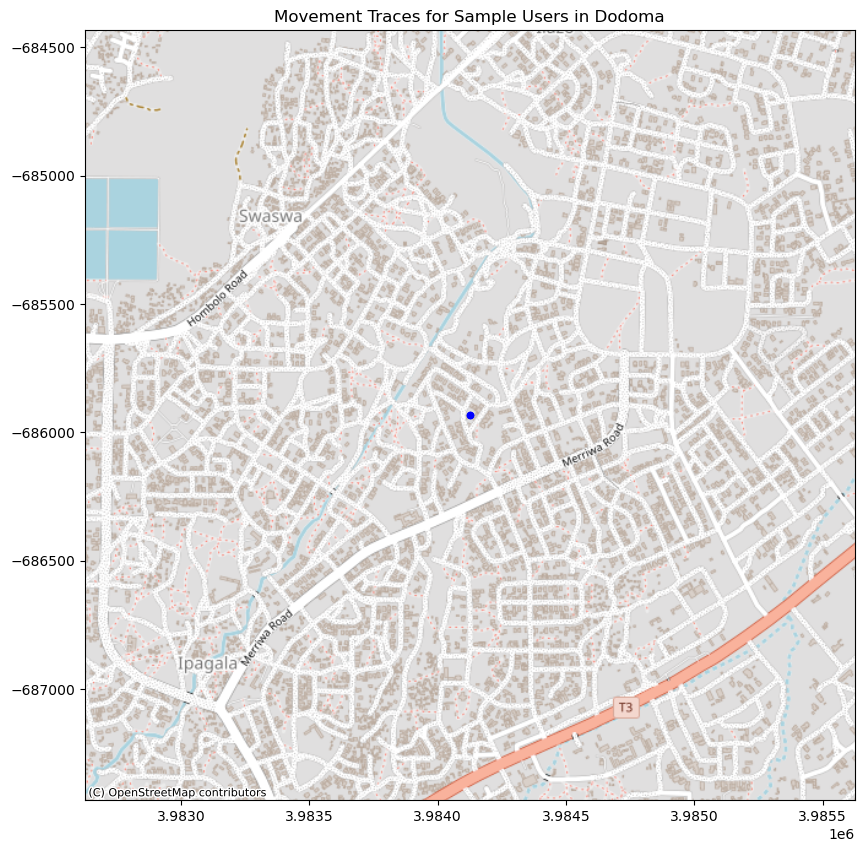

In [33]:
import geopandas as gpd
import matplotlib.pyplot as plt
import contextily as ctx

# Dodoma bounding box (lon_min, lat_min, lon_max, lat_max)
dodoma_bbox = (35.6, -6.3, 35.8, -6.1)

# Filter sample data for Dodoma
dodoma_sample_data = sample_data[
    (sample_data['longitude'] >= dodoma_bbox[0]) & (sample_data['longitude'] <= dodoma_bbox[2]) &
    (sample_data['latitude']  >= dodoma_bbox[1]) & (sample_data['latitude'] <= dodoma_bbox[3])
]

# Convert to GeoDataFrame
dodoma_sample_gdf = gpd.GeoDataFrame(
    dodoma_sample_data,
    geometry=gpd.points_from_xy(dodoma_sample_data.longitude, dodoma_sample_data.latitude),
    crs="EPSG:4326"
)

# Convert to Web Mercator for contextily
dodoma_sample_gdf_3857 = dodoma_sample_gdf.to_crs(epsg=3857)

# Compute bounding box in Web Mercator
minx, miny, maxx, maxy = dodoma_sample_gdf_3857.total_bounds
padding = 1500  # meters of padding around points

# Plot
fig, ax = plt.subplots(figsize=(10, 10))
dodoma_sample_gdf_3857.plot(ax=ax, color='blue', markersize=20)

# Set axis limits for zoom
ax.set_xlim(minx - padding, maxx + padding)
ax.set_ylim(miny - padding, maxy + padding)

# Add OSM basemap
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

plt.title('Movement Traces for Sample Users in Dodoma')
plt.show()


Some people appear in exactly the same spot on different days (e.g.: cbe2385b-a779-4083-bf8d-9fc76dcca5a6). This seems unrealistic since the stops are in different cities. E.g., this person would need to travel between Dar and Dodoma in the same day for multiple days in a row.

For the people with really short travel durations between Dar and Dodoma: Some traces seem to make sense (next to roads or bus stops), so maybe only time stamp is wrong?


### Teleporting behavior

In [11]:
# Haversine distance function: 

def haversine_km(lon1, lat1, lon2, lat2):
    """
    Vectorized haversine distance (km)
    """
    R = 6371.0  # Earth radius in km

    lon1, lat1, lon2, lat2 = map(
        np.radians, [lon1, lat1, lon2, lat2]
    )

    dlon = lon2 - lon1
    dlat = lat2 - lat1

    a = np.sin(dlat / 2)**2 + \
        np.cos(lat1) * np.cos(lat2) * np.sin(dlon / 2)**2

    c = 2 * np.arcsin(np.sqrt(a))
    return R * c

# Compute speeds:

# Sort properly
data  = data.sort_values(["device_id", "timestamp"])

# Create lagged values per individual
data[["lat_next", "lon_next", "time_next"]] = (
    data.groupby("device_id")[["latitude", "longitude", "timestamp"]]
       .shift(-1)
)

# Distance in km
data["dist_km"] = haversine_km(
    data["longitude"], data["latitude"],
    data["lon_next"], data["lat_next"]
)

# Time difference in hours
data["dt_hours"] = (
    (data["time_next"] - data["timestamp"])
    .dt.total_seconds() / 3600
)

# Speed km/h
data["speed_kmh"] = data["dist_km"] / data["dt_hours"]


In [12]:
# Convert speed to 0 if device did not move
data.loc[data["dist_km"] < 0.01, "speed_kmh"] = 0

In [15]:
# How many pings have speed > 200 km/h?
high_speed_count = (data["speed_kmh"] > 150).sum()
print(f"Number of pings with speed > 150 km/h: {high_speed_count}")

# How many unique users have at least one high-speed ping?
high_speed_users = data.loc[data["speed_kmh"] > 150, "device_id"].nunique()
print(f"Number of unique users with at least one high-speed ping: {high_speed_users}")

Number of pings with speed > 150 km/h: 0
Number of unique users with at least one high-speed ping: 0


There are 140299 (2%) pings with a speed over 150 km/h, and 21159 users (10%) with at least one high-speed ping. What happens if I remove these pings from the dataset. 

In [14]:
# Just as a test, drop all pings with speed > 150 km/h
data = data[data["speed_kmh"] <= 150]


## Train Stations, Airport etc. 

In [34]:
# Zoom in on people who have travelled between Dar and Dodoma
def is_in_bbox(lon, lat, bbox):
    return bbox[0] <= lon <= bbox[2] and bbox[1] <= lat <= bbox[3]

dar_airport_bbox = (39.202, -6.874, 39.210, -6.868)  # example bbox for Dar airport
dar_train_bbox = (39.282, -6.82, 39.285, -6.81)    # example bbox for train station
#station_lon = 39.283019  station_lat = -6.824930 

dar_pings = users_df[users_df['city'] == 'Dar es Salaam']

dar_airport_pings = dar_pings[dar_pings.apply(lambda row: is_in_bbox(row['longitude'], row['latitude'], dar_airport_bbox), axis=1)]
dar_train_pings = dar_pings[dar_pings.apply(lambda row: is_in_bbox(row['longitude'], row['latitude'], dar_train_bbox), axis=1)]

print("Pings at Dar airport:")
print(dar_airport_pings)
print("Pings at Dar train station:")
print(dar_train_pings) 


Pings at Dar airport:
                                  device_id        date           city  \
1569   21d86015-0ce1-453d-a6cb-c17603c12f8a  2025-10-02  Dar es Salaam   
1573   21d86015-0ce1-453d-a6cb-c17603c12f8a  2025-10-02  Dar es Salaam   
1574   21d86015-0ce1-453d-a6cb-c17603c12f8a  2025-10-02  Dar es Salaam   
1577   21d86015-0ce1-453d-a6cb-c17603c12f8a  2025-10-02  Dar es Salaam   
1578   21d86015-0ce1-453d-a6cb-c17603c12f8a  2025-10-02  Dar es Salaam   
...                                     ...         ...            ...   
6040   7724a8f8-2f67-4d21-afb6-bbd431213f10  2025-10-06  Dar es Salaam   
6042   7724a8f8-2f67-4d21-afb6-bbd431213f10  2025-10-06  Dar es Salaam   
14181  86a07d5a-f19c-4f2c-a2cd-b5e6a3c51f1b  2025-10-01  Dar es Salaam   
17124  7724a8f8-2f67-4d21-afb6-bbd431223f10  2025-10-06  Dar es Salaam   
17130  7724a8f8-2f67-4d21-afb6-bbd431223f10  2025-10-06  Dar es Salaam   

                       timestamp  longitude  latitude  duration_hours  
1569   2025-10-02

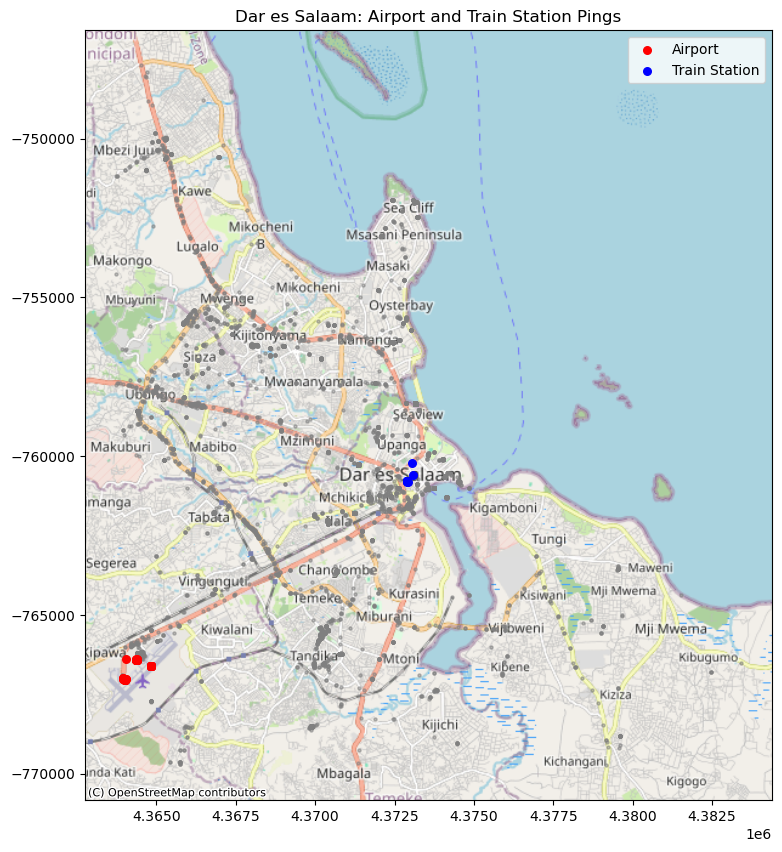

In [35]:
import contextily as ctx
import geopandas as gpd

dar_gdf = gpd.GeoDataFrame(
    dar_pings,
    geometry=gpd.points_from_xy(dar_pings.longitude, dar_pings.latitude),
    crs="EPSG:4326"
).to_crs(epsg=3857)

fig, ax = plt.subplots(figsize=(10, 10))
dar_gdf.plot(ax=ax, color='gray', markersize=5, alpha=0.5)
gpd.GeoDataFrame(geometry=gpd.points_from_xy(dar_airport_pings.longitude, dar_airport_pings.latitude), crs="EPSG:4326").to_crs(epsg=3857).plot(ax=ax, color='red', markersize=30, label='Airport')
gpd.GeoDataFrame(geometry=gpd.points_from_xy(dar_train_pings.longitude, dar_train_pings.latitude), crs="EPSG:4326").to_crs(epsg=3857).plot(ax=ax, color='blue', markersize=30, label='Train Station')

ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)
plt.legend()
plt.title("Dar es Salaam: Airport and Train Station Pings")
plt.show()


In [36]:
import pandas as pd
import geopandas as gpd
from shapely.geometry import Point
import pyproj
import plotly.express as px
import math

# ---------- 1) DATA PREP ----------
# df should contain columns: 'timestamp', 'latitude', 'longitude', optionally 'user_id'
data['timestamp'] = pd.to_datetime(data['timestamp'], errors='coerce')
data = data.dropna(subset=['timestamp', 'latitude', 'longitude']).copy()

# Keep original lat/lon for plotting (WGS84)
data['latitude'] = data['latitude'].astype(float)
data['longitude'] = data['longitude'].astype(float)

# ---------- 2) MAKE GeoDataFrame and ensure CRS is set to WGS84 ----------
gdf = gpd.GeoDataFrame(data, geometry=gpd.points_from_xy(data.longitude, data.latitude))
gdf.set_crs(epsg=4326, inplace=True)  # geographic CRS

# ---------- 3) CHOOSE A PROJECTED CRS (meters) ----------
# Option A: Automatic UTM based on station coordinates (good for city/local analysis)
station_lon = 39.283019  # replace with your station lon
station_lat = -6.824930  # replace with your station lat

def utm_epsg_from_lonlat(lon, lat):
    zone = int((lon + 180) / 6) + 1
    if lat >= 0:
        epsg = 32600 + zone  # Northern hemisphere
    else:
        epsg = 32700 + zone  # Southern hemisphere
    return epsg

utm_epsg = utm_epsg_from_lonlat(station_lon, station_lat)  # e.g., 32737 for lon~39E southern hemisphere


# Use UTM by default:
proj_crs = pyproj.CRS.from_epsg(utm_epsg)
print("Using projected CRS:", proj_crs)

# ---------- 4) REPROJECT to projected CRS (meters) and compute distances ----------
gdf_m = gdf.to_crs(proj_crs)  # in meters

# Create a station point in projected CRS to compute distance
station_geom_wgs84 = Point(station_lon, station_lat)
station_g = gpd.GeoSeries([station_geom_wgs84], crs="EPSG:4326").to_crs(proj_crs)
station_proj_point = station_g.iloc[0]

# Compute distance (in meters)
gdf_m['distance_m'] = gdf_m.geometry.distance(station_proj_point)

# Subset to within radius (e.g., 1000 m)
radius_m = 1000  # meters
near_station_m = gdf_m[gdf_m['distance_m'] <= radius_m].copy()

# If you want the subset back in WGS84 for plotting, join with original lat/lon
near_station_wgs84 = near_station_m.to_crs(epsg=4326)
near_station_wgs84['latitude']  = near_station_wgs84.geometry.y
near_station_wgs84['longitude'] = near_station_wgs84.geometry.x

# ---------- 5) OPTIONAL: reduce temporal resolution if many points ----------
# e.g., aggregate to 5-minute bins for animation frame labels
#near_station_wgs84['time_bin'] = near_station_wgs84['timestamp'].dt.floor('5T')

# ---------- 6) PLOTLY ANIMATION (interactive) ----------
# Use time_bin or timestamp formatted as string
near_station_wgs84['time_str'] = near_station_wgs84['timestamp'].dt.strftime('%Y-%m-%d %H:%M')

fig = px.scatter_mapbox(
    near_station_wgs84.sort_values('timestamp'),
    lat='latitude',
    lon='longitude',
    color='user_id' if 'user_id' in near_station_wgs84.columns else None,
    animation_frame='time_str',
    hover_name='user_id' if 'user_id' in near_station_wgs84.columns else None,
    mapbox_style='open-street-map',
    zoom=15,
    height=700,
    title=f'GPS pings within {radius_m} m of station'
)
fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0})
fig.show()




Using projected CRS: EPSG:32737


In [ ]:
import pandas as pd
import plotly.express as px

# ---- 1. Prepare data ----
data = data.dropna(subset=['timestamp', 'latitude', 'longitude'])

# Pick ONE DAY (replace date as needed) since plotting all days is too heavy
day = '2025-10-01'
df_day = data[data['timestamp'].dt.date == pd.to_datetime(day).date()].copy()

# Optional: aggregate to 5-minute bins to lighten load
df_day['time_bin'] = df_day['timestamp'].dt.floor('30T')

# ---- 2. Filter spatially near the station ----
# Example: Dar es Salaam station coordinates
station_lat, station_lon = -6.824930, 39.283019

# Keep only points within a small bounding box (~few hundred meters)
df_day = df_day[
    (df_day['latitude'] > station_lat - 0.005) & (df_day['latitude'] < station_lat + 0.005) &
    (df_day['longitude'] > station_lon - 0.005) & (df_day['longitude'] < station_lon + 0.005)
]

# ---- 3. Create animation ----
fig = px.scatter_mapbox(
    df_day.sort_values('time_bin'),
    lat='latitude',
    lon='longitude',
    color='user_id' if 'user_id' in df_day.columns else None,
    animation_frame='time_bin',  # <-- use datetime directly!
    mapbox_style='carto-positron',
    zoom=17,
    center={'lat': -6.824930, 'lon': 39.283019},
    title='GPS pings near Dar es Salaam train station (local time)',
    height=700
)

fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0})
fig.show()


C:\Users\zollner\AppData\Local\Temp\ipykernel_18804\1149033816.py:12: FutureWarning:

'T' is deprecated and will be removed in a future version, please use 'min' instead.



In [48]:
fig.write_html("train_station_activity.html")

In [49]:
# Define station bounding box
station_lat, station_lon = -6.824930, 39.283019
lat_tol = 0.0005
lon_tol = 0.0005

# Filter all points near the station
station_points = data[
    (data['latitude'] > station_lat - lat_tol) &
    (data['latitude'] < station_lat + lat_tol) &
    (data['longitude'] > station_lon - lon_tol) &
    (data['longitude'] < station_lon + lon_tol)
]

# Pick one user_id who was at the station
user_to_track = station_points['device_id'].iloc[6]
print(f"Tracking user: {user_to_track}")
#show timestamp of this user when this person was around trainstation
print(station_points[station_points['device_id'] == user_to_track]['timestamp'])

user_data = data[data['device_id'] == user_to_track].copy()

# Make sure it's sorted by time
user_data = user_data.sort_values('timestamp')

import plotly.express as px

fig = px.scatter_mapbox(
    user_data,
    lat='latitude',
    lon='longitude',
    animation_frame='timestamp',  # or 'timestamp' for full resolution
    mapbox_style='carto-positron',
    zoom=12,
    center={'lat': station_lat, 'lon': station_lon},
    title=f'Movement of user {user_to_track} over the week',
    height=700
)

fig.update_layout(margin={"r":0,"t":40,"l":0,"b":0})
fig.show()


Tracking user: 5953c632-bec2-4db2-8f3e-3e192683807d
288359    2025-10-01 18:42:13+03:00
294797    2025-10-01 18:08:48+03:00
295758    2025-10-01 20:17:04+03:00
373856    2025-10-01 20:49:17+03:00
376175    2025-10-01 18:42:22+03:00
1246008   2025-10-02 12:55:42+03:00
1246363   2025-10-02 23:13:48+03:00
1248042   2025-10-02 13:36:07+03:00
1251953   2025-10-02 11:46:35+03:00
1264185   2025-10-02 14:11:26+03:00
1275004   2025-10-02 16:57:51+03:00
1277843   2025-10-02 14:14:06+03:00
1281480   2025-10-02 14:17:04+03:00
1292705   2025-10-02 21:28:15+03:00
1293755   2025-10-02 16:51:50+03:00
1304960   2025-10-02 11:39:22+03:00
1305421   2025-10-02 13:13:45+03:00
1305900   2025-10-02 13:42:50+03:00
1309690   2025-10-02 13:44:10+03:00
1327989   2025-10-02 16:01:37+03:00
1329950   2025-10-02 11:21:03+03:00
1331292   2025-10-02 12:34:49+03:00
1335413   2025-10-02 17:15:06+03:00
1339095   2025-10-02 11:43:50+03:00
1347578   2025-10-02 20:18:03+03:00
1348876   2025-10-02 11:45:41+03:00
1355118   20

# Findings

I need multiple pings per user per day. For comparison, in Blanchard et al. they only use people who show up for 10 nights and 50% in the same spot over night, and for  8 distinct weekdays at work and 50% of total weekdays at the same spot. 

For Tanzania, they have 237,123 (22,994) (high-confidence) users with 457 (2,132) pings over one entire year. For the big sample, they have a bit more than 1 ping per day (similar to this sample where I have 1.3 pings per user). In the high confidence sample, they have around 6 pings per day. - None of this would be enough to plot trajectories/transport mode/speed etc. 

# What do I need the data for? 

- Comparison of mobility patterns before/after -> e.g. frequency, spatial extent, densities, specific locations visited
--> Do I think the SGR has impacted these "longer visits" ? Since I will likely not see within day travel
--> less people at airports and busstations, more at trainstations?
- More research on "consumption trips" and how they are influenced by better transport connections?